In this **comparative study**, we will perform a **Decision Tree Classifier** to predict if the insured will file a claim or not

In [1]:
# Step 1: Retrieve a dataset from a CSV Excel file

import pandas as pd # Allow us to work with CSV files. 

# Print the CE802_P2_Data.csv dataset with only 2 decimal digits and highlight missing values such as "nan"
pd.set_option("display.max_rows", None, "display.max_columns", None) # Print the entire Pandas dataframe (All the 1500 Rows)

dataset = pd.read_csv(r'C:\Users\Julio\Documents\RESPALDO\Tareas\University of Essex\Machine Learning\Assignment\CE802_P2_Data.csv')
dataset.style.format("{:.2f}") \
             .highlight_null('yellow') \
             .set_caption("CE802_P2_Data.csv Dataset") # Print CE802_P2_Data.csv dataset

# r'Paste here the whole path where the CE802_P2_Data.csv file has been saved'
# r'' indicates a raw string
# Character "\" allows to concatenate different DataFrame.Style properties (format, highlight_null & set_caption)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,Class
0,11.70,4.02,-4.34,9.90,29.79,89.58,0.63,23.00,10.35,158.56,-7.88,0.03,1.00,1.96,nan,0.00
1,11.70,4.20,-3.68,10.98,17.46,179.58,0.05,11.00,8.30,110.56,-3.10,0.84,1.00,1.50,nan,0.00
2,37.70,25.80,3.60,0.48,12.24,407.58,-0.29,230.00,4.06,254.56,6.68,21.60,10.00,7.63,nan,1.00
3,7.70,5.40,0.30,9.42,19.86,119.58,0.29,12.00,7.61,66.56,-1.84,1.05,1.00,2.27,12.17,1.00
4,15.70,5.58,-2.58,16.34,17.49,146.58,-0.64,25.00,9.86,106.56,-4.36,1.68,1.00,1.28,nan,0.00
5,15.70,2.55,0.50,16.54,19.65,179.58,-0.78,21.00,8.69,92.56,-2.62,1.89,1.00,1.52,nan,0.00
6,11.70,4.38,-11.68,15.18,17.76,62.58,0.78,38.00,8.35,140.56,-3.26,2.37,1.00,1.87,12.70,1.00
7,37.70,41.25,10.06,0.08,4.26,77.58,0.40,140.00,4.37,184.56,-0.90,20.25,10.00,7.43,11.09,0.00
8,17.70,45.75,6.68,-0.36,1.86,-132.42,-0.36,255.00,2.58,174.56,7.32,27.30,10.00,7.63,nan,1.00
9,37.70,25.50,8.64,2.90,5.76,-102.42,-1.58,65.00,3.86,424.56,4.68,24.45,10.00,6.83,nan,0.00


In [2]:
# Step 2: Handling missing values (Part 1)

# Finding missing values
print ('''
As we can see above, the '''+'\033[1m'+'F15 feature'+'\033[0m'+''' has nan values, which means that the value 
is not available there (missing)'''+'\n')
print (dataset.isnull().sum()) # Output: One table showing the total of missing values (nan) for each Column in the given dataset

# Checking the percentage of missing values.
F15_NullValuesPercentage = (dataset['F15'].isnull().sum()/dataset.shape[0]*100).round(2) # Output: Percentage of missing values
F15_NullValuesCount = dataset['F15'].isnull().sum() # Output: Count of missing values

print ('''
To be more precise, there are '''+'\033[1m'+'%s missing values'%(F15_NullValuesCount)+'\033[0m'+''' in F15 feature.
In other words, about '''+'\033[1m'+'%s'%(F15_NullValuesPercentage)+'%'+'\033[0m'+''' of the F15 feature values are missing (750/1500)''')

# Code '\033[1m' and '\033[0m' allow to print a string in bold.


As we can see above, the F15 feature has nan values, which means that the value 
is not available there (missing)

F1         0
F2         0
F3         0
F4         0
F5         0
F6         0
F7         0
F8         0
F9         0
F10        0
F11        0
F12        0
F13        0
F14        0
F15      750
Class      0
dtype: int64

To be more precise, there are 750 missing values in F15 feature.
In other words, about 50.0% of the F15 feature values are missing (750/1500)



It can be concluded from the Missing Value Matrix that there is no relationship between the missingness of the data 
and any values (observed or missing). 
There is no systematic assumption that makes some data likely to be missing than others. (MCAR Assumption)

Note: white lines indicate missing values in F15 column. However, none of them seems to follow a trend by themselves
or with any other feature.


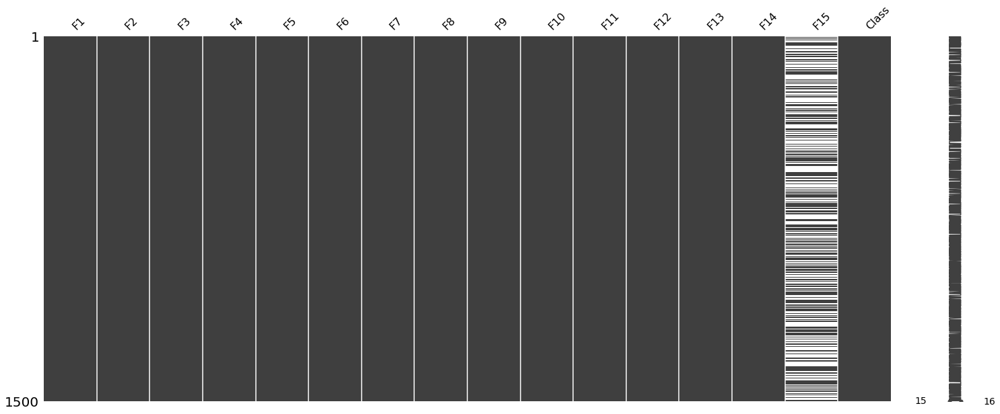

In [3]:
# Step 2: Handling missing values (Part 2)

# Diagnosing missing values 
import missingno as msno # Allow us to plot and analize randomness in data

ax = msno.matrix(dataset)
print ('''
It can be concluded from the Missing Value Matrix that there is no relationship between the missingness of the data 
and any values (observed or missing). 
There is no systematic assumption that makes some data likely to be missing than others. (MCAR Assumption)

Note: white lines indicate missing values in F15 column. However, none of them seems to follow a trend by themselves
or with any other feature.''')

# Uncomment the following 2 lines if you want to install Missingno library into any Jupyter Notebook Environment
#import sys
#!{sys.executable} -m pip install missingno

In [4]:
# Step 2: Handling missing values (Part 3)

# Dropping F15 feature
print ('\nFrom the above analysis, it is clear that %s'%(F15_NullValuesPercentage)+'''% of the data does not have F15 updated. 
Additionally, it could be understood that there are no other features linked to F15 that will help us to find out 
whether the customer will complain or not. Thus, F15 feature will be dropped.

As shown in the table, there is no Missing values after dropping F15 Feature:''')

dataset_drop15 = dataset.drop(columns='F15')
dataset_drop15.style.format("{:.2f}") \
                    .highlight_null('yellow') \
                    .set_caption("CE802_P2_Data.csv Dataset after drop F15 feature") # Print CE802_P2_Data.csv dataset after dropping F15 feature

# Character "\" allows to concatenate different DataFrame.Style properties (format, highlight_null & set_caption)


From the above analysis, it is clear that 50.0% of the data does not have F15 updated. 
Additionally, it could be understood that there are no other features linked to F15 that will help us to find out 
whether the customer will complain or not. Thus, F15 feature will be dropped.

As shown in the table, there is no Missing values after dropping F15 Feature:


,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,Class
0,11.70,4.02,-4.34,9.90,29.79,89.58,0.63,23.00,10.35,158.56,-7.88,0.03,1.00,1.96,0.00
1,11.70,4.20,-3.68,10.98,17.46,179.58,0.05,11.00,8.30,110.56,-3.10,0.84,1.00,1.50,0.00
2,37.70,25.80,3.60,0.48,12.24,407.58,-0.29,230.00,4.06,254.56,6.68,21.60,10.00,7.63,1.00
3,7.70,5.40,0.30,9.42,19.86,119.58,0.29,12.00,7.61,66.56,-1.84,1.05,1.00,2.27,1.00
4,15.70,5.58,-2.58,16.34,17.49,146.58,-0.64,25.00,9.86,106.56,-4.36,1.68,1.00,1.28,0.00
5,15.70,2.55,0.50,16.54,19.65,179.58,-0.78,21.00,8.69,92.56,-2.62,1.89,1.00,1.52,0.00
6,11.70,4.38,-11.68,15.18,17.76,62.58,0.78,38.00,8.35,140.56,-3.26,2.37,1.00,1.87,1.00
7,37.70,41.25,10.06,0.08,4.26,77.58,0.40,140.00,4.37,184.56,-0.90,20.25,10.00,7.43,0.00
8,17.70,45.75,6.68,-0.36,1.86,-132.42,-0.36,255.00,2.58,174.56,7.32,27.30,10.00,7.63,1.00
9,37.70,25.50,8.64,2.90,5.76,-102.42,-1.58,65.00,3.86,424.56,4.68,24.45,10.00,6.83,0.00


In [5]:
# Step 3: Split the dataset in feature variables (independent variables) and target variable (dependent Variable)

# Automatically obtain the features names from a CSV File
features_name = pd.read_csv(r'C:\Users\Julio\Documents\RESPALDO\Tareas\University of Essex\Machine Learning\Assignment\CE802_P2_Data.csv', skiprows=0, nrows=1)
features_name_list = features_name.columns.to_list() 

X = features_name_list[:14] # This feature variable will exclude F15 feature (dropped) and the target variable (Class)
print ('''These are the feature variables (X):
%s\n''' %(X))

Y = features_name_list[-1:] #This target variable will include only the last element in a list (Class)
print ('''This is the target variable (Y):
%s''' %(Y))

# Randomise the dataset after dropping F15 feature
from sklearn.utils import shuffle # Allow us to arrange in random order all the records (rows)
dataset_drop15_rand = shuffle(dataset_drop15)
dataset_drop15_rand = dataset_drop15_rand
dataset_drop15_rand.style.format("{:.2f}") \
                         .set_caption("Randomised CE802_P2_Data.csv dataset after dropping F15 feature") # Print a Random CE802_P2_Data.csv dataset after dropping F15 feature

These are the feature variables (X):
['F1', 'F2', 'F3', 'F4', 'F5', 'F6', 'F7', 'F8', 'F9', 'F10', 'F11', 'F12', 'F13', 'F14']

This is the target variable (Y):
['Class']


,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,Class
1296,17.70,24.90,7.30,2.76,9.75,122.58,-0.83,110.00,4.54,54.56,5.08,15.15,10.00,6.83,0.00
95,15.70,3.39,1.16,12.98,18.00,182.58,-0.43,33.00,10.49,128.56,-2.82,2.28,1.00,1.66,0.00
1496,17.70,29.40,8.00,-0.48,3.54,-102.42,1.17,100.00,3.76,304.56,6.78,29.25,10.00,7.53,1.00
970,57.70,18.00,9.58,-1.28,2.01,287.58,-1.64,200.00,4.19,464.56,7.28,19.20,10.00,10.43,1.00
328,17.70,34.65,7.64,5.28,11.76,-42.42,1.26,355.00,6.11,204.56,0.60,16.65,10.00,6.33,0.00
1200,37.70,21.15,9.94,0.68,4.95,182.58,0.62,325.00,2.96,424.56,6.54,16.05,10.00,9.48,0.00
1107,17.70,18.15,10.06,-0.62,5.46,-57.42,0.31,50.00,2.66,254.56,6.92,30.75,10.00,8.18,1.00
462,37.70,33.60,9.14,0.92,6.24,-87.42,-0.67,190.00,2.97,324.56,7.42,17.10,10.00,9.48,1.00
1171,11.70,5.43,1.44,9.02,16.98,134.58,-0.89,28.00,7.97,146.56,-4.38,2.58,1.00,2.05,1.00
300,11.70,2.01,-5.76,10.76,24.03,149.58,-0.21,8.00,7.61,98.56,-4.20,2.13,1.00,2.21,1.00


In [6]:
# Step 4: Split the dataset into training set and testing set (Part 1)

# Transfering the data into 2 numpy arrays
import numpy as np # Allow us to work with arrays
np.set_printoptions(threshold=np.inf, precision=2, suppress=True, linewidth=180) # Print all the values of an array as a pretty table (all values in one row)

x = dataset_drop15_rand.loc[:, dataset_drop15_rand.columns != 'Class'].to_numpy() # This array contains all the feature variable values.
y = dataset_drop15_rand.loc[:, 'Class'].to_numpy() # This array contains ONLY the target variable values.
print('\n'+'\033[1m'+'Array of feature variables:'+'\033[0m', x.shape) 
print(x) # Output: All possible elements of the array. (This includes only values until F14 feature from dataset: "dataset_drop15_rand")

np.set_printoptions(threshold=np.inf, precision=0, suppress=True, linewidth=5) # Print all the values of an array vertically (one value in one row) 
print('\n'+'\033[1m'+'Array of target variable:'+'\033[0m', y.shape)
print(y) # Output: All possible elements of the array. (This includes only values of "Class" feature from dataset: "dataset_drop15_rand")

# Code '\033[1m' and '\033[0m' allow to print a string in bold.


Array of feature variables: (1500, 14)
[[  17.7    24.9     7.3     2.76    9.75  122.58   -0.83  110.      4.54   54.56    5.08   15.15   10.      6.83]
 [  15.7     3.39    1.16   12.98   18.    182.58   -0.43   33.     10.49  128.56   -2.82    2.28    1.      1.66]
 [  17.7    29.4     8.     -0.48    3.54 -102.42    1.17  100.      3.76  304.56    6.78   29.25   10.      7.53]
 [  57.7    18.      9.58   -1.28    2.01  287.58   -1.64  200.      4.19  464.56    7.28   19.2    10.     10.43]
 [  17.7    34.65    7.64    5.28   11.76  -42.42    1.26  355.      6.11  204.56    0.6    16.65   10.      6.33]
 [  37.7    21.15    9.94    0.68    4.95  182.58    0.62  325.      2.96  424.56    6.54   16.05   10.      9.48]
 [  17.7    18.15   10.06   -0.62    5.46  -57.42    0.31   50.      2.66  254.56    6.92   30.75   10.      8.18]
 [  37.7    33.6     9.14    0.92    6.24  -87.42   -0.67  190.      2.97  324.56    7.42   17.1    10.      9.48]
 [  11.7     5.43    1.44    9.02   16.9

In [7]:
# Step 4: Split the dataset into training set and testing set (Part 2)

# Split the dataset "dataset_drop15_rand" into training Set (70% of the rows) and testing set (30% of the rows)
from sklearn.model_selection import train_test_split # Import train_test_split function
X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size=0.3, random_state=1)

X_train_lenght = len(X_train) # Output: How many samples does the training feature variables set contain
Y_train_lenght = len(Y_train) # Output: How many samples does the training target variable set contain

X_test_lenght = len(X_test)  # Output: How many samples does the testing feature variables set contain
Y_test_lenght = len(Y_test)  # Output: How many samples does the testing target variable set contain

print ('''\nAccording to Dangeti (2017), "in practice, data usually will be split randomly 70:30 into train and test
datasets respectively in statistical modeling"\n''')

np.set_printoptions(threshold=np.inf, precision=2, suppress=True, linewidth=120) # Print all the values of an array as a pretty table (all values in one row)
print ('For the previous reason, the '+'\033[1m'+'training set for the feature variables '+'\033[0m'+ 'will contain '+'\033[1m'+'%s samples.' %(X_train_lenght)+'\033[0m')
# Uncomment the following line to see the whole training dataset for the feature variables (X)
#print (X_train)
print ('For the previous reason, the '+'\033[1m'+'training set for the target variable '+'\033[0m'+ 'will contain '+'\033[1m'+'%s samples.' %(Y_train_lenght)+'\033[0m'+'\n')
# Uncomment the following line to see the whole training dataset for the target variable (Y)
#print (Y_train)
print ('For the previous reason, the '+'\033[1m'+'testing set for the feature variables '+'\033[0m'+ 'will contain '+'\033[1m'+'%s samples.' %(X_test_lenght)+'\033[0m')
# Uncomment the following line to see the whole testing dataset for the feature variables (X)
#print (X_test)
print ('For the previous reason, the '+'\033[1m'+'testing set for the target variable '+'\033[0m'+ 'will contain '+'\033[1m'+'%s samples.' %(Y_test_lenght)+'\033[0m')
# Uncomment the following line to see the whole testing dataset for the target variable (Y)
#print (Y_test)

# Code '\033[1m' and '\033[0m' allow to print a string in bold.


According to Dangeti (2017), "in practice, data usually will be split randomly 70:30 into train and test
datasets respectively in statistical modeling"

For the previous reason, the training set for the feature variables will contain 1050 samples.
For the previous reason, the training set for the target variable will contain 1050 samples.

For the previous reason, the testing set for the feature variables will contain 450 samples.
For the previous reason, the testing set for the target variable will contain 450 samples.


In [8]:
# Step 5: Build the decision tree classifiers (Part 1)

# Create the decision tree classifer object with gini index
from sklearn.tree import DecisionTreeClassifier # Import decision tree classifier
DTC_gini = DecisionTreeClassifier(criterion = "gini", random_state = 1, max_depth = 3, min_samples_leaf = 6) 

# "max_depth = 3"        According to Scikit-learn.org, this option is used as an initial tree depth to get a feel how
#                        the tree is fitting to the data, avoiding overfitting.
# "min_samples_leaf = 6" According to Scikit-learn.org, this option is used as an initial value that guarantees that
#                        each leaf has a minimum size, avoiding low-variance and over-lift nodes.
# Gini impurity is a criterion to minimize the probability of misclassification. 

# Create the decision tree classifer object with entropy
DTC_entropy = DecisionTreeClassifier(criterion = "entropy", random_state = 1, max_depth = 3, min_samples_leaf = 3) 

# "max_depth = 3"        According to Scikit-learn.org, this option is used as an initial tree depth to get a feel how
#                        the tree is fitting to the data, avoiding overfitting.
# "min_samples_leaf = 6" According to Scikit-learn.org, this option is used as an initial value that guarantees that
#                        each leaf has a minimum size, avoiding low-variance and over-lift nodes.
# Entropy is a criterion that indicates the disorder of the features with the target.  

print ("Decision tree objects have been created succesfully")

Decision tree objects have been created succesfully


In [9]:
# Step 5: Build the decision tree classifiers (Part 2)

# Train both decision tree classifier objects 
DTC_gini = DTC_gini.fit(X_train,Y_train) # Decision tree classifier with gini index
DTC_entropy = DTC_entropy.fit(X_train,Y_train) # Decision tree classifier with entropy index

# Create a function to make predictions based on both decision tree classifiers
np.set_printoptions(threshold=np.inf, precision=3, suppress=True, linewidth=120) # Print all the values of an array horizontally 

def DTC_prediction(X_test, DTC_object):    
    Y_pred = DTC_object.predict(X_test)       
    print("Predicted values:")  
    print(Y_pred)
    return Y_pred 

# Create a function to calculate the accuracy of each decision tree classifier
from sklearn import metrics # Import scikit-learn metrics module for accuracy calculation
from sklearn.metrics import classification_report, confusion_matrix # Import scikit-learn.metrics module for precision, recall, f1-score, support calculation and confusion matrix
def DTC_accuracy(Y_test, Y_pred): 
     print ("\nAccuracy: ", metrics.accuracy_score(Y_test,Y_pred)*100, '%\n')
    
print ('''\n1. Decision tree classifier objects have been trained succesfully.
2. Functions have been created succesfully''')


1. Decision tree classifier objects have been trained succesfully.
2. Functions have been created succesfully


In [10]:
# Step 6: Evaluate the performance of the decision tree classifiers (Part 1)

# Predictions using gini  
print('\033[1m'+'\nEvaluation results using gini index:\n'+'\033[0m') 
Y_pred_gini = DTC_prediction(X_test, DTC_gini)
DTC_accuracy(Y_test, Y_pred_gini) # Model accuracy is how often the classifier is correct.
print(classification_report(Y_test, Y_pred_gini)) # Output: Classification report table
cm_gini = pd.DataFrame(confusion_matrix(Y_test, Y_pred_gini),
                  columns=['Predicted:False', 'Predicted:True'],
                  index=['Class:False', 'Class:True'])
print(cm_gini) # Output: Confusion Matrix
print ('\nTo sum up, the decision tree classifier with gini index has classified '+'\033[1m'+'%s'%("{:.4%}".format(metrics.accuracy_score(Y_test,Y_pred_gini)))+'\033[0m'+''' of the clients correctly
as customers who file or not file a claim, based on the historical data provided by the manager.

In other words, if the manager takes 100 random customers from the whole database, 
our algorithm will be misclassifying only '''+'\033[1m'+'%s clients'%("{:.0f}".format(100-metrics.accuracy_score(Y_test,Y_pred_gini)*100))+'\033[0m'+'''
This not too bad if we consider that anything over 50% means the model is better than random. However, we should consider
applying different methods in preprocessing phase in order to improve the accuracy of the model\n''')

# Predictions using entropy  
print('\033[1m'+'Evaluation results using entropy index:\n'+'\033[0m') 
Y_pred_entropy = DTC_prediction(X_test, DTC_entropy)
DTC_accuracy(Y_test, Y_pred_entropy) # Model accuracy is how often the classifier is correct.
print(classification_report(Y_test, Y_pred_entropy)) # Output: Classification report table
cm_entropy = pd.DataFrame(confusion_matrix(Y_test, Y_pred_entropy),
                  columns=['Predicted:False', 'Predicted:True'],
                  index=['Class:False', 'Class:True'])
print(cm_entropy) # Output: Confusion matrix
print ('\nTo sum up, the decision tree classifier with entropy index has classified '+'\033[1m'+'%s'%("{:.4%}".format(metrics.accuracy_score(Y_test,Y_pred_entropy)))+'\033[0m'+''' of the clients correctly
as customers who file or not file a claim, based on the historical data provided by the manager.

In other words, if the manager takes 100 random customers from the whole database, 
our algorithm will be misclassifying only '''+'\033[1m'+'%s clients'%("{:.0f}".format(100-metrics.accuracy_score(Y_test,Y_pred_entropy)*100))+'\033[0m'+'''
This not too bad if we consider that anything over 50% means the model is better than random. However, we should consider
applying different methods in preprocessing phase in order to improve the accuracy of the model\n''')

# Code '\033[1m' and '\033[0m' allow to print a string in bold.


Evaluation results using gini index:

Predicted values:
[False False False False False  True False False  True  True False  True False  True False False  True False False
  True  True  True False False False  True False  True False  True  True False False False False  True False False
  True False  True False  True False False  True False False False  True False  True  True False  True  True False
  True False False False  True False False  True False  True  True  True  True False False False False False False
 False False False  True  True False  True  True False False  True False False  True  True False  True False  True
 False False  True False  True  True False False False False False  True False False False  True  True False False
 False  True  True False False False False  True False False False  True False  True  True  True False False False
 False  True  True  True  True False False False False  True False  True False  True  True False False  True  True
 False  True  True  Tru

In [11]:
# Step 6: Evaluate the performance of the decistion tree classifiers (Part 2)

# Comparing real values vs predicted values with gini index
df = pd.DataFrame()
df.insert(0,"Real",Y_test,True) # Insert the real values of the column "Class" (Obtained from the testing set)
df.insert(1,"Gini Index Prediction",Y_pred_gini,True) # Insert the predicted values obtained either with gini model (Y_pred_gini) or entropy model (Y_pred_entropy) 

# Create a function to check if the values of two columns are equal
def Check(df):
   if df['Real']== df['Gini Index Prediction']:
      return "Good Prediction"
   else:
      return "Bad Prediction" 
df['Comparison'] = df.apply(Check, axis=1)

print('''\nAs shown in the table below, "Bad prediction" means that the model could not forecast correctly the 
categorie of the customer, while "Good Prediction" means that the decision tree classifier predicted well''')

df.style.where(lambda val: 'Bad Prediction' in str(val), 'color: red', subset=['Comparison']) \
  .set_properties(**{'text-align': 'center'}) # Output: "real vs predicted table"


As shown in the table below, "Bad prediction" means that the model could not forecast correctly the 
categorie of the customer, while "Good Prediction" means that the decision tree classifier predicted well


,Real,Gini Index Prediction,Comparison
0,False,False,Good Prediction
1,False,False,Good Prediction
2,False,False,Good Prediction
3,False,False,Good Prediction
4,False,False,Good Prediction
5,False,True,Bad Prediction
6,False,False,Good Prediction
7,True,False,Bad Prediction
8,True,True,Good Prediction
9,True,True,Good Prediction


**Result interpretations**

##### Classification_report
|Metric|Description|
|:--|:-------------------------------|
|Precision of the positive classes correctly predicted |The number that is actually positive|
|Recall |The number predicted correctly (the higher, the better)|
|F1-score |Harmonic mean between precision and recall|
|Support score for the model|The number of occurrences of the given class in the dataset|
|Confusion matrix|The correct and incorrect classifications of our decision tree model|

**Notes**: 
1. The predictions change according to the datasets given. Remember these sets were randomised
2. The predictions change according to the train_test_split percentage.
3. The bias and variance in each dataset could have an impact in predictions.
4. To increase the accuracy, we can split the dataset into many smalls datasets, then create models, and again consolidate the results to get an optimum accuracy.

In [12]:
# Step 7: Print the decistion tree classifiers (Part 1)

# Create a function to print the decision tree classifier based on both DTCs
def printTree(DTC):     
    feature_names = X
    c_class = dataset['Class'].astype(str) # Convert boolean data (Column "Class") to string data
    target_names = c_class.unique() # Get only unique values. In this case: ['False' & 'True']
    
    #Build the tree
    import graphviz # Import graphviz library to print the decision tree classifier
    from sklearn import tree # Import tree library to build the content of the decision tree classifier
    dot_data = tree.export_graphviz(DTC, out_file=None, feature_names=feature_names, class_names=target_names, filled=True, rounded=True)
    
    #Draw the tree
    DecisionTreeClassifier = graphviz.Source(dot_data, format ="jpg")
    return DecisionTreeClassifier

print ('''\n1. The Function has been created succesfully''')

# Troubleshooting to Install Graphviz and pydotplus to see the Decision Tree:

# 1. Install pydotplus via conda: conda install pydotplus
# 2. Install graphviz independently: conda install python-graphviz
# 3. Find the graphviz.py file in your pydotplus installation directory, in my case, it was in the following path:
#    C:\Users\Julio\miniconda3\Lib\site-packages\pydotplus
# 4. Open graphviz.py and find this block in line 606:


#    # Method 3 (Windows only)
# if os.sys.platform == 'win32':

    # Try and work out the equivalent of "C:\Program Files" on this
    # machine (might be on drive D:, or in a different language)
    # if 'PROGRAMFILES' in os.environ:
        # Note, we could also use the win32api to get this
        # information, but win32api may not be installed.
        # path = os.path.join(
            # os.environ['PROGRAMFILES'], 'ATT', 'GraphViz', 'bin'
        # )
    # else:
        # Just in case, try the default...
        # path = r"C:\Program Files\att\Graphviz\bin"  <--- Here. This must be replaced

   # progs = __find_executables(path)


# 5. Comment the if/else part and hardcode the path of your graphviz installation directory. 
#    Inside you should find the executables (dot.exe, circo.exe, gvedit.exe, etc.)). The new code has to look like this:


#    Method 3 (Windows only)
# if os.sys.platform == 'win32':

        # Try and work out the equivalent of "C:\Program Files" on this
        # machine (might be on drive D:, or in a different language)
        # """if 'PROGRAMFILES' in os.environ:
            # Note, we could also use the win32api to get this
            # information, but win32api may not be installed.
            # path = os.path.join(
                # os.environ['PROGRAMFILES'], 'ATT', 'GraphViz', 'bin'
            # )
        # else:
            # Just in case, try the default...
            # path = r"C:\Users\Julio\miniconda3\Library\bin\graphviz" <---- Here. This my graphviz installation directory
            # """
        # progs = __find_executables(path)

        
# Uncomment the following 2 lines if you want to install Graphviz Library into any Jupyter Notebook Environment
#import sys
#!{sys.executable} -m pip install graphviz

# Uncomment the following 2 lines if you want to install pydotplus Library into any Jupyter Notebook Environment
#import sys
#!{sys.executable} -m pip install pydotplus



1. The Function has been created succesfully



Decision tree classifier using gini Index:

Model accuracy:  70.88888888888889 %



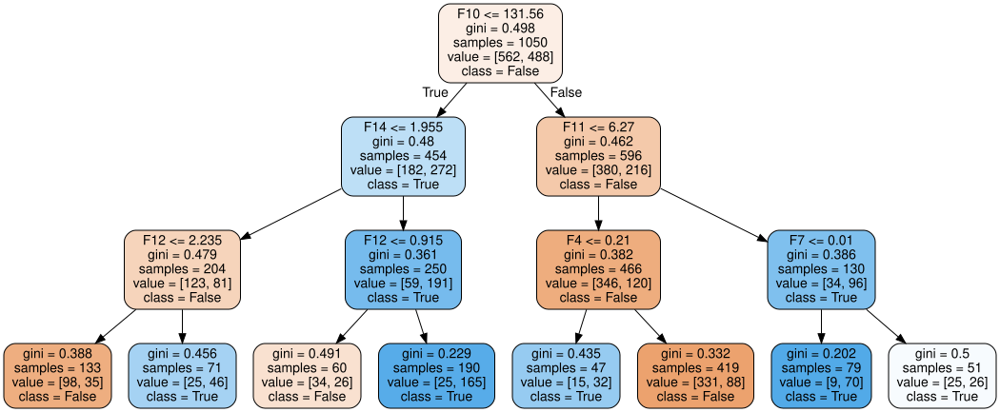

In [13]:
# Step 7: Print the decistion tree classifiers (Part 2)

# Print the decision tree classifier using gini index
print('\033[1m'+'\nDecision tree classifier using gini Index:\n'+'\033[0m')
print ("Model accuracy: ", metrics.accuracy_score(Y_test,Y_pred_gini)*100, '%\n') # Output: accuracy of gini model
DecisionTreeClassifier_gini = printTree(DTC_gini) 
DecisionTreeClassifier_gini 

# Code '\033[1m' and '\033[0m' allow to print a string in bold.


Decision tree classifier using entropy Index:

Model accuracy:  70.88888888888889 %



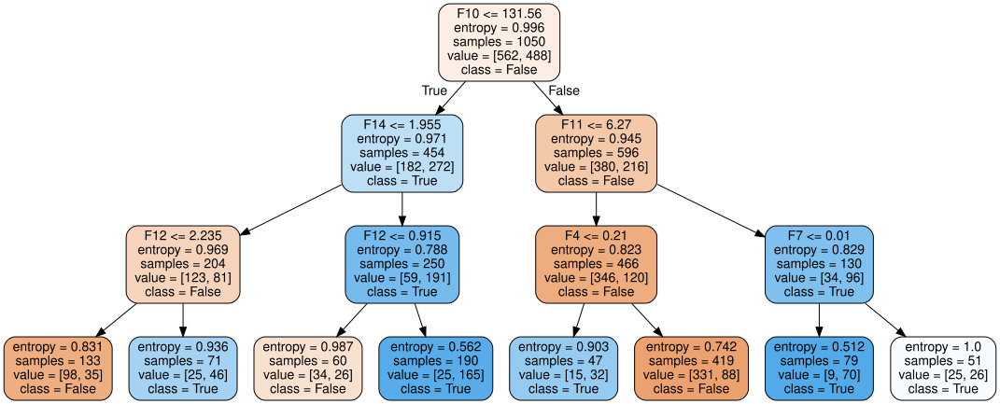

In [14]:
# Step 7: Print the decistion tree classifiers (Part 3)

# Print the decision tree classifier using entropy index
print('\033[1m'+'\nDecision tree classifier using entropy Index:\n'+'\033[0m')
print ("Model accuracy: ", metrics.accuracy_score(Y_test,Y_pred_entropy)*100, '%\n') # Output: accuracy of entropy model
DecisionTreeClassifier_entropy = printTree(DTC_entropy) 
DecisionTreeClassifier_entropy

# Code '\033[1m' and '\033[0m' allow to print a string in bold.

**Results interpretations**:

From the above predictions of both decision tree classifier models, we can see that feature <font color='blue'>**F10**</font> is the root node, which indicates that <font color='blue'>**F10**</font> is the main factor that impacts into the customer decision whether him/her will claim his/her travel-insurance or not.

**Notes**
1. The ‘value’ row in each node tells us how many of the observations that were sorted into that node fall into each of our two categories (False/True)

In this **comparative study - Part 2**, we will perform 2 more **machine learning techniques** to predict if the insured will file a claim or not:

1. **Random forest classifier** 
2. **Logistic regression**

In [15]:
# Step 1: Retrieve a dataset from a CSV Excel file (Done in cell 1)
# Step 2: Handling missing values (Part 1) (Done in cell 2)
# Step 2: Handling missing values (Part 2) (Done in cell 3)
# Step 2: Handling missing values (Part 3)

# Imputing missing values in F15 feature
print ('''\nIn our first model (decision tree classifier), we have decided to drop F15 Feature because of the missing values.
But now, we will replace the nan values with the mean of the column "F15" as the assignments suggest us.  
Additionally, Zhang (2018) mentions that "dropping data can introduce biases and it should be the last option 
when is about handling missing values".

As shown in the table, there is no missing values after imputing F15 feature with the mean:''')

# fill all missing values with the mean of column "F15"
dataset_imputation = dataset.fillna(dataset.mean(), inplace=False)
dataset_imputation.style.format("{:.2f}") \
                  .highlight_null('yellow') \
                  .set_caption("CE802_P2_Data.csv dataset after F15 mean imputation") # Print CE802_P2_Data.csv dataset after F15 mean imputation

# KNN Imputation method
#from sklearn.impute import KNNImputer
#imputer = KNNImputer(n_neighbors=2)
#imputation = imputer.fit_transform(dataset)
#df_KNN = pd.DataFrame(imputation)
#df_KNN
        


In our first model (decision tree classifier), we have decided to drop F15 Feature because of the missing values.
But now, we will replace the nan values with the mean of the column "F15" as the assignments suggest us.  
Additionally, Zhang (2018) mentions that "dropping data can introduce biases and it should be the last option 
when is about handling missing values".

As shown in the table, there is no missing values after imputing F15 feature with the mean:


,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,Class
0,11.70,4.02,-4.34,9.90,29.79,89.58,0.63,23.00,10.35,158.56,-7.88,0.03,1.00,1.96,10.85,0.00
1,11.70,4.20,-3.68,10.98,17.46,179.58,0.05,11.00,8.30,110.56,-3.10,0.84,1.00,1.50,10.85,0.00
2,37.70,25.80,3.60,0.48,12.24,407.58,-0.29,230.00,4.06,254.56,6.68,21.60,10.00,7.63,10.85,1.00
3,7.70,5.40,0.30,9.42,19.86,119.58,0.29,12.00,7.61,66.56,-1.84,1.05,1.00,2.27,12.17,1.00
4,15.70,5.58,-2.58,16.34,17.49,146.58,-0.64,25.00,9.86,106.56,-4.36,1.68,1.00,1.28,10.85,0.00
5,15.70,2.55,0.50,16.54,19.65,179.58,-0.78,21.00,8.69,92.56,-2.62,1.89,1.00,1.52,10.85,0.00
6,11.70,4.38,-11.68,15.18,17.76,62.58,0.78,38.00,8.35,140.56,-3.26,2.37,1.00,1.87,12.70,1.00
7,37.70,41.25,10.06,0.08,4.26,77.58,0.40,140.00,4.37,184.56,-0.90,20.25,10.00,7.43,11.09,0.00
8,17.70,45.75,6.68,-0.36,1.86,-132.42,-0.36,255.00,2.58,174.56,7.32,27.30,10.00,7.63,10.85,1.00
9,37.70,25.50,8.64,2.90,5.76,-102.42,-1.58,65.00,3.86,424.56,4.68,24.45,10.00,6.83,10.85,0.00


In [16]:
# Step 3: Split dataset in feature variables (independent variables) and target variable (dependent variable)(Done in cell 5)
# Step 4: Split the dataset into training set and testing set (Part 1)

# Transfering the data into 2 numpy arrays (New imputation dataset)
np.set_printoptions(threshold=np.inf, precision=2, suppress=True, linewidth=140) # Print all the values of an array as a pretty table (all values in one row) 

x_i = dataset_imputation.loc[:, dataset_imputation.columns != "Class"].to_numpy() # This array contains all the feature variable values.
y_i = dataset_imputation.loc[:, "Class"].to_numpy() # This array contains ONLY the target variable values.
print('\n'+'\033[1m'+'Array of feature variables:'+'\033[0m', x_i.shape) 
print(x_i) # Output: All possible elements of the array. (This includes all values except "Class" column from dataset: "dataset_imputation")

np.set_printoptions(threshold=np.inf, precision=0, suppress=True, linewidth=5) # Print all the values of an array vertically (one value in one row)
print('\n'+'\033[1m'+'Array of target variables:'+'\033[0m', y_i.shape)
print(y_i) # All possible elements of the array. (This includes only values of "Class" feature from dataset: "dataset_imputation")

# Code '\033[1m' and '\033[0m' allow to print a string in bold.


Array of feature variables: (1500, 15)
[[  11.7     4.02   -4.34    9.9    29.79   89.58    0.63   23.     10.35  158.56   -7.88    0.03    1.      1.96   10.85]
 [  11.7     4.2    -3.68   10.98   17.46  179.58    0.05   11.      8.3   110.56   -3.1     0.84    1.      1.5    10.85]
 [  37.7    25.8     3.6     0.48   12.24  407.58   -0.29  230.      4.06  254.56    6.68   21.6    10.      7.63   10.85]
 [   7.7     5.4     0.3     9.42   19.86  119.58    0.29   12.      7.61   66.56   -1.84    1.05    1.      2.27   12.17]
 [  15.7     5.58   -2.58   16.34   17.49  146.58   -0.64   25.      9.86  106.56   -4.36    1.68    1.      1.28   10.85]
 [  15.7     2.55    0.5    16.54   19.65  179.58   -0.78   21.      8.69   92.56   -2.62    1.89    1.      1.52   10.85]
 [  11.7     4.38  -11.68   15.18   17.76   62.58    0.78   38.      8.35  140.56   -3.26    2.37    1.      1.87   12.7 ]
 [  37.7    41.25   10.06    0.08    4.26   77.58    0.4   140.      4.37  184.56   -0.9    20.25  

In [17]:
# Step 4: Split the dataset into training set and testing set (Part 2)

# Split the dataset "dataset_imputation" into training set (70% of the rows) and testing set (30% of the rows)
Xi_train, Xi_test, Yi_train, Yi_test = train_test_split(x_i, y_i, test_size=0.3, random_state=1)

Xi_train_lenght = len(Xi_train) # Output: How many samples does the training feature variables set contain
Yi_train_lenght = len(Yi_train) # Output: How many samples does the training target variable set contain

Xi_test_lenght = len(Xi_test)  # Output: How many samples does the testing feature variables set contain
Yi_test_lenght = len(Yi_test)  # Output: How many samples does the testing target variable set contain

print ('''\nAccording to Dangeti (2017), "in practice, data usually will be split randomly 70:30 into train and test
datasets respectively in statistical modeling"\n''')

np.set_printoptions(threshold=np.inf, precision=2, suppress=True, linewidth=120) # Print all the values of an array as a pretty table (all values in one row)
print ('For the previous reason, the '+'\033[1m'+'training set for the feature variables '+'\033[0m'+ 'will contain '+'\033[1m'+'%s samples.' %(Xi_train_lenght)+'\033[0m')
# Uncomment the following line to see the whole training dataset for the feature variables (X)
#print (Xi_train)
print ('For the previous reason, the '+'\033[1m'+'training set for the target variable '+'\033[0m'+ 'will contain '+'\033[1m'+'%s samples.' %(Yi_train_lenght)+'\033[0m'+'\n')
# Uncomment the following line to see the whole training dataset for the target variable (Y)
#print (Yi_train)
print ('For the previous reason, the '+'\033[1m'+'testing set for the feature variables '+'\033[0m'+ 'will contain '+'\033[1m'+'%s samples.' %(Xi_test_lenght)+'\033[0m')
# Uncomment the following line to see the whole testing dataset for the feature variables (X)
#print (Xi_test)
print ('For the previous reason, the '+'\033[1m'+'testing set for the target variable '+'\033[0m'+ 'will contain '+'\033[1m'+'%s samples.' %(Yi_test_lenght)+'\033[0m')
# Uncomment the following line to see the whole testing dataset for the target variable (Y)
#print (Yi_test)

# Code '\033[1m' and '\033[0m' allow to print a string in bold.
# Random_state randomise the whole dataset, so no need to randomise manually as we explained in cell 5


According to Dangeti (2017), "in practice, data usually will be split randomly 70:30 into train and test
datasets respectively in statistical modeling"

For the previous reason, the training set for the feature variables will contain 1050 samples.
For the previous reason, the training set for the target variable will contain 1050 samples.

For the previous reason, the testing set for the feature variables will contain 450 samples.
For the previous reason, the testing set for the target variable will contain 450 samples.


In [18]:
# Step 5: Build the random forest classifier & logistic regression (Part 1)

# Create the random forest classifer object
from sklearn.ensemble import RandomForestClassifier # Import random forest classifier
RFC = RandomForestClassifier(random_state =1)

print ("Random forest object has been created succesfully")

# Create the logistic regression object
from sklearn.linear_model import LogisticRegression # Import logistic regression
logr = LogisticRegression(solver='lbfgs', max_iter=4000)

print ("Logistic regression object has been created succesfully")

# solver='lbfgs'    L-BFGS is a limited memory of BFGS, which is in the family of quasi-Newton methods that approximate
#                   the BFGS algorithm, which utilizes a limited amount of computer memory.
#                   BFGS is currently considered the most effective, and is by far the most popular, quasi-Newton update formula
# max_iter = 4000   This is the maximum number of iterations taken for the solvers to converge. (It is good with lbfgs)

Random forest object has been created succesfully
Logistic regression object has been created succesfully


In [19]:
# Step 5: Build the random forest classifier and logistic regression (Part 2)

# Train both random forest classifier and logistic Regression
RFC = RFC.fit(Xi_train,Yi_train) # Random forest classifier model
logr = logr.fit(Xi_train,Yi_train) # Logistic regression model

print ('''\n1. Random forest classifier and Logistic regression objects have been trained succesfully.
2. Functions have been created succesfully''')


1. Random forest classifier and Logistic regression objects have been trained succesfully.
2. Functions have been created succesfully


In [20]:
# Step 6: Evaluate the performance of the random forest classifier and logistic regression (Part 1)

# Predictions using random forest classifier (imputation set)
print('\033[1m'+'\nEvaluation results using random forest classifier:\n'+'\033[0m') 
Y_pred_RFC = DTC_prediction(Xi_test, RFC)
DTC_accuracy(Yi_test, Y_pred_RFC) # Model accuracy is how often the classifier is correct.
print(classification_report(Yi_test, Y_pred_RFC)) # Output: Classification report table
cm_gini = pd.DataFrame(confusion_matrix(Yi_test, Y_pred_RFC),
                  columns=['Predicted:False', 'Predicted:True'],
                  index=['Class:False', 'Class:True'])
print(cm_gini) # Output: Confusion matrix
print ('\nTo sum up, the random forest classifier has classified '+'\033[1m'+'%s'%("{:.4%}".format(metrics.accuracy_score(Yi_test,Y_pred_RFC)))+'\033[0m'+''' of the clients correctly
as customers who file or not file a claim, based on the historical data provided by the manager.

In other words, if the manager takes 100 random customers from the whole database, 
our algorithm will be misclassifying only '''+'\033[1m'+'%s clients'%("{:.0f}".format(100-metrics.accuracy_score(Yi_test,Y_pred_RFC)*100))+'\033[0m'+'''
This not too bad if we consider that anything over 50% means the model is better than random. However, we should consider
applying different methods in preprocessing phase in order to improve the accuracy of the model\n''')

# Predictions using logistic regression (imputation set)
print('\033[1m'+'\nEvaluation results using logistic regression:\n'+'\033[0m') 
Y_pred_logr = DTC_prediction(Xi_test, logr)
DTC_accuracy(Yi_test, Y_pred_logr) # Model accuracy is how often the classifier is correct.
print(classification_report(Yi_test, Y_pred_logr)) # Output: Classification report table
cm_gini = pd.DataFrame(confusion_matrix(Yi_test, Y_pred_logr),
                  columns=['Predicted:False', 'Predicted:True'],
                  index=['Class:False', 'Class:True'])
print(cm_gini) # Output: Confusion matrix
print ('\nTo sum up, the logistic regression has classified '+'\033[1m'+'%s'%("{:.4%}".format(metrics.accuracy_score(Yi_test,Y_pred_logr)))+'\033[0m'+''' of the clients correctly 
as customers who file or not file a claim, based on the historical data provided by the manager.

In other words, if the manager takes 100 random customers from the whole database, 
our algorithm will be misclassifying only '''+'\033[1m'+'%s clients'%("{:.0f}".format(100-metrics.accuracy_score(Yi_test,Y_pred_logr)*100))+'\033[0m'+'''
This not too bad if we consider that anything over 50% means the model is better than random. However, we should consider
applying different methods in preprocessing phase in order to improve the accuracy of the model\n''')


Evaluation results using random forest classifier:

Predicted values:
[False  True  True False  True False False  True  True False  True  True  True  True  True False False False False
 False False False  True  True False False False False  True  True False False False False False False False  True
  True  True False False  True  True False  True False  True False False False False False  True  True  True False
 False  True  True  True False  True False  True  True  True False  True False  True False  True False False False
 False False False False False  True  True False False  True False  True  True False False  True False  True False
  True  True  True False  True False False  True False False  True False  True False  True False False False False
 False False  True  True  True False False  True  True False  True  True False  True  True False  True False False
  True  True  True False False  True False False  True  True  True False False False  True  True  True False  True
  True  T

In [21]:
# Step 6: Evaluate the performance of the random forest classifier and logistic regression (Part 2)

# Comparing real values vs predicted values with logistic regression
df1 = pd.DataFrame()
df1.insert(0,"Real",Yi_test,True) # Insert the real values of the column "Class" (Obtained from the testing set)
df1.insert(1,"Logistic regression prediction",Y_pred_logr,True) # Insert the predicted values obtained either with random forest classifier (Y_pred_RFC) or logistic regression model (Y_pred_logr) 

# Create a function to check if the values of two columns are equal
def Check(df1):
   if df1['Real']== df1['Logistic regression prediction']:
      return "Good Prediction"
   else:
      return "Bad Prediction" 
df1['Comparison'] = df1.apply(Check, axis=1)

print('''\nAs shown in the table below, "Bad prediction" means that the model could not forecast correctly the 
categorie of the customer, while "Good Prediction" means that the logistic regression predicted well''')

df1.style.where(lambda val: 'Bad Prediction' in str(val), 'color: red', subset=['Comparison']) \
  .set_properties(**{'text-align': 'center'}) # Output: "real vs predicted table"


As shown in the table below, "Bad prediction" means that the model could not forecast correctly the 
categorie of the customer, while "Good Prediction" means that the logistic regression predicted well


,Real,Logistic regression prediction,Comparison
0,False,False,Good Prediction
1,True,True,Good Prediction
2,True,True,Good Prediction
3,False,False,Good Prediction
4,False,False,Good Prediction
5,True,True,Good Prediction
6,False,False,Good Prediction
7,True,True,Good Prediction
8,True,True,Good Prediction
9,False,False,Good Prediction


In this **comparative study - Part B**, we will to produce class predictions of the records in the test set using **logistic regression**

In [29]:
# Step 1: Retrieve a dataset from a CSV Excel file

# Print the CE802_P2_Test.csv dataset without the class column
dataset_test = pd.read_csv(r'C:\Users\Julio\Documents\RESPALDO\Tareas\University of Essex\Machine Learning\Assignment\CE802_P2_Test.csv')
dataset_test_f15 = dataset_test.loc[:, dataset_test.columns != 'Class']
dataset_test_f15.style.format("{:.2f}") \
                .highlight_null('yellow') \
                .set_caption("CE802_P2_Test.csv dataset without the column 'Class'") # Print CE802_P2_Test.csv dataset

# r'Paste here the whole path where the CE802_P2_Test.csv file has been saved'
# r'' indicates a raw string
# Character "\" allows to concatenate different DataFrame.Style properties (format, highlight_null & set_caption)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15
0,37.70,33.15,9.26,3.88,5.91,-12.42,-0.77,165.00,3.32,334.56,4.42,18.75,10.00,7.78,nan
1,17.70,24.30,6.58,3.40,10.47,-57.42,-0.77,20.00,3.22,224.56,0.28,15.30,10.00,8.13,nan
2,37.70,17.55,10.16,-1.94,6.90,92.58,-0.84,215.00,4.71,94.56,6.98,17.70,10.00,10.08,13.27
3,11.70,2.61,-8.28,8.96,23.22,161.58,1.69,6.00,8.54,64.56,-6.52,1.32,1.00,1.80,11.73
4,7.70,5.55,1.52,8.50,21.66,95.58,2.41,22.00,10.74,128.56,-3.84,2.76,1.00,2.22,12.31
5,15.70,2.10,-0.62,11.16,20.91,161.58,3.47,13.00,8.42,108.56,-9.00,3.03,1.00,1.64,nan
6,15.70,1.68,0.54,9.92,21.84,152.58,-0.44,14.00,9.20,104.56,-3.82,1.59,1.00,1.53,nan
7,11.70,5.07,-0.06,12.70,21.15,86.58,-0.17,69.00,10.95,120.56,-1.80,2.10,1.00,2.26,nan
8,7.70,4.56,1.44,10.24,16.59,62.58,1.73,62.00,7.61,146.56,-3.06,2.73,1.00,2.10,11.91
9,15.70,0.72,0.76,9.20,21.03,128.58,0.09,14.00,10.70,102.56,-4.40,0.15,1.00,2.29,nan


In [30]:
# Step 2: Handling missing values (Part 1)

# Finding missing values
print ('''
As we can see above, the '''+'\033[1m'+'F15 feature'+'\033[0m'+''' has nan values, which means that the value 
is not available there (missing)'''+'\n')
print (dataset_test_f15.isnull().sum()) # Output: One table showing the total of missing values (nan) for each Column in the given dataset

# Checking the percentage of missing values.
F15_NullValuesPercentage_1 = (dataset_test_f15['F15'].isnull().sum()/dataset_test_f15.shape[0]*100).round(2) # Output: Percentage of missing values
F15_NullValuesCount_1 = dataset_test_f15['F15'].isnull().sum() # Output: Count of missing values

print ('''
To be more precise, there are '''+'\033[1m'+'%s missing values'%(F15_NullValuesCount_1)+'\033[0m'+''' in F15 feature.
In other words, about '''+'\033[1m'+'%s'%(F15_NullValuesPercentage_1)+'%'+'\033[0m'+''' of the F15 feature values are missing (750/1500)''')

# Code '\033[1m' and '\033[0m' allow to print a string in bold.


As we can see above, the F15 feature has nan values, which means that the value 
is not available there (missing)

F1       0
F2       0
F3       0
F4       0
F5       0
F6       0
F7       0
F8       0
F9       0
F10      0
F11      0
F12      0
F13      0
F14      0
F15    750
dtype: int64

To be more precise, there are 750 missing values in F15 feature.
In other words, about 50.0% of the F15 feature values are missing (750/1500)


Before to proceed with the imputation method, we should emphasize the following situation: 

1. We have trained and tested our logistic regression model after replacing the missing values 
   with the mean of the column "F15". 
   
Based on that situation, we should also perform another mean imputation process to handle the nan values of this new testing set.

As Géron (2017) mention "we should compute the mean value on the training set, and use it to fill the missing values 
in the training set, but also don't forget to save the mean value that you have computed. 
You will need it later to replace missing values in the test set when you want to evaluate your system, 
and also once the system goes live to replace missing values in new data"

As a result of this, we will replace the nan values with the mean calculated in the dataset "CE802_P2_Data.csv", 
because this number has been calculated from a large representative historical data. (1500)

In [31]:
# Step 2: Handling missing values (Part 2)

# Comparison of means between one column (F15) of two different datasets (CE802_P2_Data.csv & CE802_P2_Test.csv)
from IPython.display import display # Allows to print 2 dataframes in 1 Jupyter Cell
print('\nComparison of means between one column (F15) of two different datasets (CE802_P2_Data.csv & CE802_P2_Test.csv):') 

df_mean = pd.DataFrame({"F15 mean from dataset 'CE802_P2_Data.csv'":[dataset["F15"].mean()], # Output: Mean calculation from CE802_P2_Data.csv
                        "F15 mean from dataset 'CE802_P2_Test.csv'":[dataset_test["F15"].mean()]}) # Output: Mean calculation from CE802_P2_Test.csv 
display(df_mean.style.set_properties(**{'text-align': 'center'})) # Output: One table that compares two F15 means from two different datasets

# Imputing missing values in F15 feature with mean calculated in the dataset "CE802_P2_Data.csv" 
print('\nAs shown in the table, there is no missing values after imputing F15 feature with the mean (10.85):')
dataset_imputation_1 = dataset_test_f15.fillna(10.85, inplace=False)
display(dataset_imputation_1.style.format("{:.2f}") \
                    .highlight_null('yellow') \
                    .set_caption("CE802_P2_Test.csv dataset after F15 mean imputation")) # Print CE802_P2_Test.csv dataset after F15 mean imputation


Comparison of means between one column (F15) of two different datasets (CE802_P2_Data.csv & CE802_P2_Test.csv):


,F15 mean from dataset 'CE802_P2_Data.csv',F15 mean from dataset 'CE802_P2_Test.csv'
0,10.853013,10.886347



As shown in the table, there is no missing values after imputing F15 feature with the mean (10.85):


,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15
0,37.70,33.15,9.26,3.88,5.91,-12.42,-0.77,165.00,3.32,334.56,4.42,18.75,10.00,7.78,10.85
1,17.70,24.30,6.58,3.40,10.47,-57.42,-0.77,20.00,3.22,224.56,0.28,15.30,10.00,8.13,10.85
2,37.70,17.55,10.16,-1.94,6.90,92.58,-0.84,215.00,4.71,94.56,6.98,17.70,10.00,10.08,13.27
3,11.70,2.61,-8.28,8.96,23.22,161.58,1.69,6.00,8.54,64.56,-6.52,1.32,1.00,1.80,11.73
4,7.70,5.55,1.52,8.50,21.66,95.58,2.41,22.00,10.74,128.56,-3.84,2.76,1.00,2.22,12.31
5,15.70,2.10,-0.62,11.16,20.91,161.58,3.47,13.00,8.42,108.56,-9.00,3.03,1.00,1.64,10.85
6,15.70,1.68,0.54,9.92,21.84,152.58,-0.44,14.00,9.20,104.56,-3.82,1.59,1.00,1.53,10.85
7,11.70,5.07,-0.06,12.70,21.15,86.58,-0.17,69.00,10.95,120.56,-1.80,2.10,1.00,2.26,10.85
8,7.70,4.56,1.44,10.24,16.59,62.58,1.73,62.00,7.61,146.56,-3.06,2.73,1.00,2.10,11.91
9,15.70,0.72,0.76,9.20,21.03,128.58,0.09,14.00,10.70,102.56,-4.40,0.15,1.00,2.29,10.85


In [32]:
# Step 3: Split the dataset into feature set and target set

# Transfering the data into 2 numpy arrays
np.set_printoptions(threshold=np.inf, precision=2, suppress=True, linewidth=173) # Print all the values of an array as a pretty table (all values in one row)

xp = dataset_imputation_1.to_numpy() # This array contains all the feature variable values.
yp = dataset_test.loc[:, 'Class'].to_numpy() # This array contains ONLY the target variable values. (In this case this column is empty)
print('\n'+'\033[1m'+'Array of Feature Variables:'+'\033[0m', xp.shape) 
print(xp) # Output: All possible elements of the array. (This includes all values from dataset: "dataset_imputation_1")

np.set_printoptions(threshold=np.inf, precision=0, suppress=True, linewidth=5) # Print all the values of an array vertically (one value in one row)
print('\n'+'\033[1m'+'Array of Target Variables:'+'\033[0m', yp.shape)
print(yp) # All possible elements of the array. (This includes only values of "Class" feature from dataset: "dataset_test")

# Code '\033[1m' and '\033[0m' allow to print a string in bold.


Array of Feature Variables: (1500, 15)
[[  37.7    33.15    9.26    3.88    5.91  -12.42   -0.77  165.      3.32  334.56    4.42   18.75   10.      7.78   10.85]
 [  17.7    24.3     6.58    3.4    10.47  -57.42   -0.77   20.      3.22  224.56    0.28   15.3    10.      8.13   10.85]
 [  37.7    17.55   10.16   -1.94    6.9    92.58   -0.84  215.      4.71   94.56    6.98   17.7    10.     10.08   13.27]
 [  11.7     2.61   -8.28    8.96   23.22  161.58    1.69    6.      8.54   64.56   -6.52    1.32    1.      1.8    11.73]
 [   7.7     5.55    1.52    8.5    21.66   95.58    2.41   22.     10.74  128.56   -3.84    2.76    1.      2.22   12.31]
 [  15.7     2.1    -0.62   11.16   20.91  161.58    3.47   13.      8.42  108.56   -9.      3.03    1.      1.64   10.85]
 [  15.7     1.68    0.54    9.92   21.84  152.58   -0.44   14.      9.2   104.56   -3.82    1.59    1.      1.53   10.85]
 [  11.7     5.07   -0.06   12.7    21.15   86.58   -0.17   69.     10.95  120.56   -1.8     2.1   

In [33]:
# Step 4: Make predictions using logistic regression (Production CE802_P2_Test.csv dataset)
print('\033[1m'+'\nClass predictions using Logistic regression:\n'+'\033[0m') 
Y_pred_test = DTC_prediction(xp, logr) # Output: Class predictions

# xp     This is the set obtained from CE802_P2_Test.csv, which includes ALL the feature variables from F1 to F15 after mean imputation
# logr   This is the Logistic Regression Model created before


Class predictions using Logistic regression:

Predicted values:
[False
 False
  True
  True
  True
 False
 False
  True
  True
 False
  True
 False
 False
 False
 False
  True
 False
 False
 False
 False
  True
  True
  True
 False
 False
  True
  True
  True
 False
  True
 False
  True
  True
  True
 False
  True
  True
 False
 False
 False
  True
  True
 False
  True
  True
 False
 False
 False
 False
  True
 False
  True
  True
 False
 False
 False
 False
 False
  True
 False
  True
 False
 False
 False
  True
 False
  True
 False
  True
 False
 False
  True
 False
 False
  True
  True
 False
 False
  True
  True
  True
 False
 False
  True
  True
 False
 False
 False
  True
 False
  True
 False
 False
  True
  True
  True
  True
 False
  True
 False
  True
  True
  True
 False
 False
 False
 False
  True
 False
  True
 False
  True
 False
 False
 False
 False
  True
 False
  True
 False
 False
 False
  True
  True
  True
  True
  True
 False
  True
  True
  True
 False
  True
 Fal

In [34]:
# Step 5: Merge predicted values back to the original dataframe: dataset_test (CE802_P2_Test.csv)
dataset_test["Class"] = Y_pred_test

# dataset_test    This is the original set obtained directly from CE802_P2_Test.csv
# Print CE802_P2_Test.csv dataset after class predictions
print('\nCE802_P2_Test.csv dataset after class predictions')
dataset_test


CE802_P2_Test.csv dataset after class predictions


,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,Class
0,37.7,33.15,9.26,3.88,5.91,-12.42,-0.77,165,3.32,334.56,4.42,18.75,10,7.78,NaN,False
1,17.7,24.30,6.58,3.40,10.47,-57.42,-0.77,20,3.22,224.56,0.28,15.30,10,8.13,NaN,False
2,37.7,17.55,10.16,-1.94,6.90,92.58,-0.84,215,4.71,94.56,6.98,17.70,10,10.08,13.27,True
3,11.7,2.61,-8.28,8.96,23.22,161.58,1.69,6,8.54,64.56,-6.52,1.32,1,1.80,11.73,True
4,7.7,5.55,1.52,8.50,21.66,95.58,2.41,22,10.74,128.56,-3.84,2.76,1,2.22,12.31,True
5,15.7,2.10,-0.62,11.16,20.91,161.58,3.47,13,8.42,108.56,-9.00,3.03,1,1.64,NaN,False
6,15.7,1.68,0.54,9.92,21.84,152.58,-0.44,14,9.20,104.56,-3.82,1.59,1,1.53,NaN,False
7,11.7,5.07,-0.06,12.70,21.15,86.58,-0.17,69,10.95,120.56,-1.80,2.10,1,2.26,NaN,True
8,7.7,4.56,1.44,10.24,16.59,62.58,1.73,62,7.61,146.56,-3.06,2.73,1,2.10,11.91,True
9,15.7,0.72,0.76,9.20,21.03,128.58,0.09,14,10.70,102.56,-4.40,0.15,1,2.29,NaN,False


In [35]:
# Step 6: Export Pandas DataFrame to a CSV File after predictions

dataset_test.to_csv (r'C:\Users\Julio\Documents\RESPALDO\Tareas\University of Essex\Machine Learning\Assignment\CE802_P2_Test.csv', index = False)
print ('Predictions have been added succesfully')

# dataset_test    This is the original set obtained directly from CE802_P2_Test.csv
# index false     This property avoids exporting the row names (index).
# r'Paste here the whole path where the CE802_P2_Test.csv file wants to be saved'
# r'' indicates a raw string
# In this case, We have added the predictions to the original dataframe, because we want to keep the dataset as original (no imputations). This could be useful for the future

Predictions have been added succesfully


In [1]:
from sklearn.feature_extraction.text import CountVectorizer  # Import CountVectorizer library

content = ['How to format my hard disk', ' Hard disk format problems ']  # Content to be encoded
vectorizer = CountVectorizer(min_df=1)  # Create a Vectorizer Object (to transform)
x = vectorizer.fit_transform(content)  # Vectorizer object

print('''Vocabulary of a Text:
%s''' %(vectorizer.get_feature_names()))  # Print the identified unique words (No punctuations, in lower case & sorted)

print(x.toarray())
#print(X.toarray()[0])
#print(X.toarray()[1,2])

import pandas as pd
import scipy.sparse
pd.DataFrame.sparse.from_spmatrix(x)

Vocabulary of a Text:
['disk', 'format', 'hard', 'how', 'my', 'problems', 'to']
[[1 1 1 1 1 0 1]
 [1 1 1 0 0 1 0]]


,0,1,2,3,4,5,6
0,1,1,1,1,1,0,1
1,1,1,1,0,0,1,0
